# ¿Tienen las cuadras 100 metros en Córdoba?

In [ ]:
import geopandas as gpd 
import osmnx as ox
import os as os 
from shapely.geometry import LineString, Polygon, box
from shapely.ops import polygonize, polygonize_full, unary_union
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import ScalarFormatter
from matplotlib.colors import Normalize
from matplotlib.cm import ScalarMappable


Traemos información de Córdoba

Geocodificando la ciudad de Córdoba, Argentina...
Error al geocodificar Córdoba: `query` must be a string if `by_osmid` is True.
Mostrando el polígono geocodificado...


<Axes: >

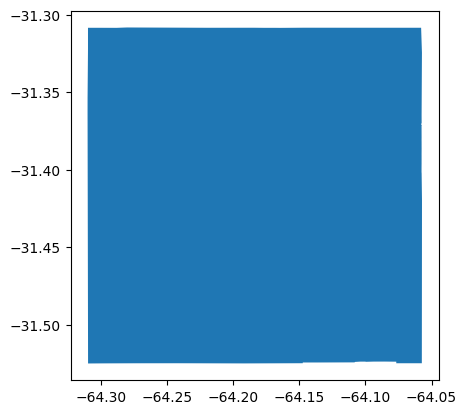

In [3]:
print("Geocodificando la ciudad de Córdoba, Argentina...")
try:
    admin_district = ox.geocode_to_gdf(5167559, by_osmid=True)
    print("Geocodificación exitosa.")
except Exception as e:
    print(f"Error al geocodificar Córdoba: {e}")
    admin_district = ox.geocode_to_gdf(
        "Córdoba, Córdoba, Argentina"
    )

print("Mostrando el polígono geocodificado...")
admin_district.plot()

inspect types and CRS


geopandas.geodataframe.GeoDataFrame

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

geopandas.geoseries.GeoSeries

types of geometries in the GeoSeries


Polygon    1
Name: count, dtype: int64

safe access to first geometry


shapely.geometry.polygon.Polygon

'Polygon'

False

bounds, centroid, area (area after reprojection for meters)


(-64.3100961, -31.5251273, -64.05725, -31.3083295)

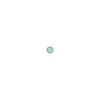

793104064.5652752

example: inspect first 10 exterior coordinates (if Polygon)


[(-64.3100961, -31.3630561),
 (-64.3100431, -31.3856806),
 (-64.309793, -31.4922796),
 (-64.3097159, -31.5251273),
 (-64.2977536, -31.5250584),
 (-64.2844809, -31.5250231),
 (-64.2758129, -31.5250001),
 (-64.2738605, -31.5249949),
 (-64.2423024, -31.524973),
 (-64.2332358, -31.5249882)]

In [ ]:
# print("inspect types and CRS")
# display(type(admin_district), admin_district.crs)
# display(type(admin_district.geometry), admin_district.geometry.dtype)

# print("types of geometries in the GeoSeries")
# display(admin_district.geometry.geom_type.value_counts())

# print("safe access to first geometry")
# geom = admin_district.geometry.iloc[0]
# display(type(geom), geom.geom_type, geom.is_empty)

# print("bounds, centroid, area (area after reprojection for meters)")
# display(geom.bounds)
# display(geom.centroid)
# display(admin_district.to_crs(epsg=3857).geometry.iloc[0].area)  # area in m^2

# print("example: inspect first 10 exterior coordinates (if Polygon)")
# if geom.geom_type == 'Polygon':
#     display(list(geom.exterior.coords)[:10])

Cargamos el grafo de la red de calles de Córdoba

In [ ]:
admin_poly = admin_district.geometry.values[0]

# Cargar el grafo de la red de calles dentro de ese polígono
print("Cargando el grafo de la red de calles de Córdoba, Argentina...")
G = ox.graph_from_polygon(admin_poly, network_type='walk')
print("Grafo cargado exitosamente.")

print('\nAnálisis de la red de calles de Córdoba, Argentina:')
print('Número de intersecciones (nodos): ', G.number_of_nodes())
print('Número de segmentos de carretera (aristas):',  G.number_of_edges())

Cargando el grafo de la red de calles de Córdoba, Argentina...
Grafo cargado exitosamente.

Análisis de la red de calles de Córdoba, Argentina:
Número de intersecciones (nodos):  37068
Número de segmentos de carretera (aristas): 115444



Visualizando el grafo...


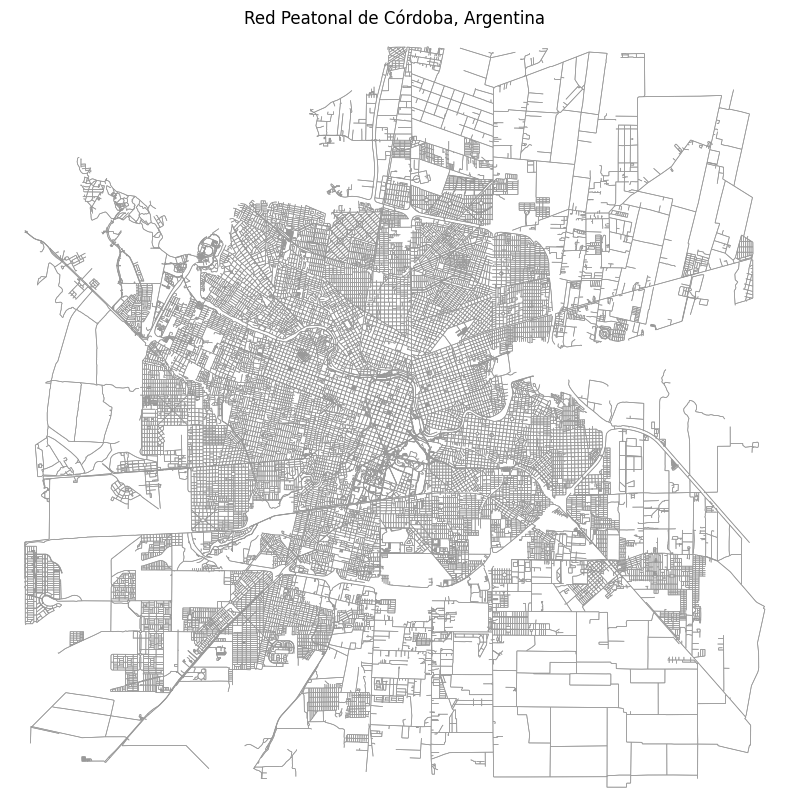

In [6]:
print("\nVisualizando el grafo...")
fig, ax = ox.plot_graph(G, figsize=(10, 10), node_size=0, bgcolor='white', edge_linewidth=0.5, show=False, close=False)
plt.title("Red Peatonal de Córdoba, Argentina")
plt.show()

Ahora vamos a computar el largo de las cuadras

In [ ]:
G_proj = ox.project_graph(G)
nodes_proj, edges_proj = ox.graph_to_gdfs(G_proj, nodes=True, edges=True)
display(edges_proj.head())

osmid      highway lanes  \
u          v          key                                              
249490924  1183719611 0                 170994019      primary     2   
1183719611 3917218322 0                 388531850  residential   NaN   
           2751262759 0                 581438541  residential   NaN   
           249490924  0                 170994019      primary     2   
           6013444904 0    [580697120, 388433069]      primary     2   

                                               name  oneway     ref reversed  \
u          v          key                                                      
249490924  1183719611 0    Avenida Amadeo Sabattini   False  RN1V09     True   
1183719611 3917218322 0                    Cangallo   False     NaN    False   
           2751262759 0                    Cangallo   False     NaN     True   
           249490924  0    Avenida Amadeo Sabattini   False  RN1V09    False   
           6013444904 0    Avenida Amadeo Sabattini   False  RN1V09     True   

                               length  \
u          v          key               
249490924  1183719611 0    378.982078   
1183719611 3917218322 0      9.701583   
           2751262759 0     14.253421   
           249490924  0    378.982078   
           6013444904 0    312.120253   

                                                                    geometry  \
u          v          key                                                      
249490924  1183719611 0    LINESTRING (393387.018 6520383.41, 393496.12 6...   
1183719611 3917218322 0    LINESTRING (393646.702 6520108.726, 393640.62 ...   
           2751262759 0    LINESTRING (393646.702 6520108.726, 393656.067...   
           249490924  0    LINESTRING (393646.702 6520108.726, 393594.716...   
           6013444904 0    LINESTRING (393646.702 6520108.726, 393665.221...   

                          maxspeed junction bridge tunnel width access  \
u          v          key                                                
249490924  1183719611 0        NaN      NaN    NaN    NaN   NaN    NaN   
1183719611 3917218322 0        NaN      NaN    NaN    NaN   NaN    NaN   
           2751262759 0        NaN      NaN    NaN    NaN   NaN    NaN   
           249490924  0        NaN      NaN    NaN    NaN   NaN    NaN   
           6013444904 0        NaN      NaN    NaN    NaN   NaN    NaN   

                          service area  
u          v          key               
249490924  1183719611 0       NaN  NaN  
1183719611 3917218322 0       NaN  NaN  
           2751262759 0       NaN  NaN  
           249490924  0       NaN  NaN  
           6013444904 0       NaN  NaN

In [ ]:
lines = unary_union(edges_proj.geometry.values)
polys, dangles, cuts, invalids = polygonize_full(lines)

In [9]:
display(lines)

In [10]:
display(polys)

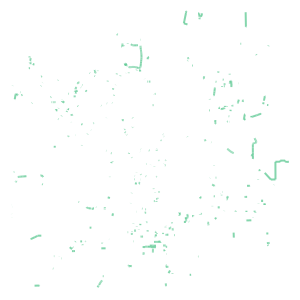

In [11]:
display(dangles)

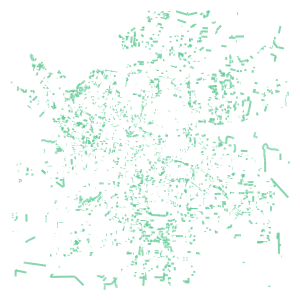

In [12]:
display(cuts)

In [13]:
display(invalids)

In [14]:
# polygonize_full may return a GeometryCollection (not directly iterable),
# so normalize to a list of Polygon objects. Fall back to polygonize() if needed.
if hasattr(polys, "geoms"):
    poly_list = [p for p in polys.geoms if isinstance(p, Polygon)]
else:
    try:
        poly_list = list(polys)
    except TypeError:
        poly_list = list(polygonize(lines))

display(poly_list)

[<POLYGON ((393646.702 6520108.726, 393640.62 6520101.181, 393658.857 6520085...>,
 <POLYGON ((393640.62 6520101.181, 393646.702 6520108.726, 393665.221 6520092...>,
 <POLYGON ((393646.702 6520108.726, 393656.067 6520119.452, 393699.493 652008...>,
 <POLYGON ((396564.882 6522618.272, 396469.021 6522724.417, 396501.575 652272...>,
 <POLYGON ((396469.021 6522724.417, 396564.882 6522618.272, 396591.535 652259...>,
 <POLYGON ((396591.535 6522590.491, 396564.882 6522618.272, 396569.735 652262...>,
 <POLYGON ((388123.64 6531239.638, 388122.803 6531342.879, 388121.567 6531438...>,
 <POLYGON ((388122.803 6531342.879, 388123.64 6531239.638, 387644.669 6531312...>,
 <POLYGON ((388123.64 6531239.638, 388123.689 6531234.118, 388125.244 6531117...>,
 <POLYGON ((388123.689 6531234.118, 388160.445 6531238.202, 388194.895 653123...>,
 <POLYGON ((387497.074 6531332.341, 387488.388 6531269.46, 387380.662 6531287...>,
 <POLYGON ((388113.478 6532406.76, 388115.566 6532426.005, 388124.962 6532425...>,
 <PO

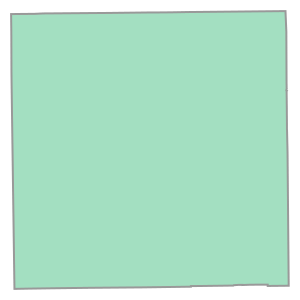

[<POLYGON ((393646.702 6520108.726, 393640.62 6520101.181, 393658.857 6520085...>,
 <POLYGON ((393640.62 6520101.181, 393646.702 6520108.726, 393665.221 6520092...>,
 <POLYGON ((393646.702 6520108.726, 393656.067 6520119.452, 393699.493 652008...>,
 <POLYGON ((396564.882 6522618.272, 396469.021 6522724.417, 396501.575 652272...>,
 <POLYGON ((396469.021 6522724.417, 396564.882 6522618.272, 396591.535 652259...>,
 <POLYGON ((396591.535 6522590.491, 396564.882 6522618.272, 396569.735 652262...>,
 <POLYGON ((388123.64 6531239.638, 388122.803 6531342.879, 388121.567 6531438...>,
 <POLYGON ((388122.803 6531342.879, 388123.64 6531239.638, 387644.669 6531312...>,
 <POLYGON ((388123.64 6531239.638, 388123.689 6531234.118, 388125.244 6531117...>,
 <POLYGON ((388123.689 6531234.118, 388160.445 6531238.202, 388194.895 653123...>,
 <POLYGON ((387497.074 6531332.341, 387488.388 6531269.46, 387380.662 6531287...>,
 <POLYGON ((388113.478 6532406.76, 388115.566 6532426.005, 388124.962 6532425...>,
 <PO

,geometry
0,"POLYGON ((393646.702 6520108.726, 393640.62 65..."
1,"POLYGON ((393640.62 6520101.181, 393646.702 65..."
2,"POLYGON ((393646.702 6520108.726, 393656.067 6..."
3,"POLYGON ((396564.882 6522618.272, 396469.021 6..."
4,"POLYGON ((396469.021 6522724.417, 396564.882 6..."


In [ ]:
admin_proj = admin_district.to_crs(edges_proj.crs).geometry.iloc[0]
blocks = [p for p in poly_list if p.is_valid and p.intersects(admin_proj)]
blocks_gdf = gpd.GeoDataFrame({'geometry': blocks}, crs=edges_proj.crs)

display(admin_proj)
display(blocks)
display(blocks_gdf.head())

In [16]:
# 4) for each block compute edge segment lengths (exterior edges)
def edge_lengths_of_polygon(poly):
    coords = list(poly.exterior.coords)
    seg_lengths = []
    for i in range(len(coords)-1):
        seg = LineString([coords[i], coords[i+1]])
        seg_lengths.append(seg.length)
    return seg_lengths

blocks_gdf['edge_lengths'] = blocks_gdf.geometry.apply(edge_lengths_of_polygon)
blocks_gdf['n_edges'] = blocks_gdf['edge_lengths'].apply(len)
blocks_gdf['mean_edge'] = blocks_gdf['edge_lengths'].apply(lambda L: float(np.mean(L)) if L else np.nan)
blocks_gdf['min_edge'] = blocks_gdf['edge_lengths'].apply(lambda L: float(np.min(L)) if L else np.nan)
blocks_gdf['max_edge'] = blocks_gdf['edge_lengths'].apply(lambda L: float(np.max(L)) if L else np.nan)
blocks_gdf['perimeter'] = blocks_gdf.geometry.length

In [32]:
# 5) quick summary
print("blocks:", len(blocks_gdf))
display(blocks_gdf.iloc[0])
print(blocks_gdf[['n_edges', 'mean_edge', 'min_edge','max_edge','perimeter']].describe())

blocks: 20787


geometry        POLYGON ((393646.70178014034 6520108.725680221...
edge_lengths    [9.690401405570563, 24.128561635481784, 68.012...
n_edges                                                       362
mean_edge                                               34.880055
min_edge                                                 1.222565
max_edge                                               261.498025
perimeter                                            16255.694548
Name: 0, dtype: object

            n_edges     mean_edge      min_edge      max_edge     perimeter
count  20787.000000  20787.000000  20787.000000  20787.000000  20787.000000
mean       8.932169     62.164513     27.571179    118.060733    438.563228
std       14.253266     36.675022     30.505989     80.650343    692.473214
min        3.000000      0.123461      0.061207      0.143939      0.370383
25%        4.000000     33.841272      4.622294     79.617540    277.930238
50%        6.000000     60.859163     10.483147    114.462844    384.663117
75%        9.000000     87.202162     54.389324    140.931464    469.939166
max      810.000000    897.339030    343.418912   1869.048797  42077.469162


blocks total: 20787; kept (mean_edge < 70 m): 12131
mean_edge range in kept blocks: 0.1 – 70.0 m
          mean_edge     perimeter
count  12131.000000  12131.000000
mean      37.657943    389.962440
std       19.051054    763.136315
min        0.123461      0.370383
25%       21.477791    178.037728
50%       38.392154    317.391820
75%       53.856674    436.306223
max       69.994960  42077.469162
Saved plot to: images/blocks_mean_edge_lt_70m.png


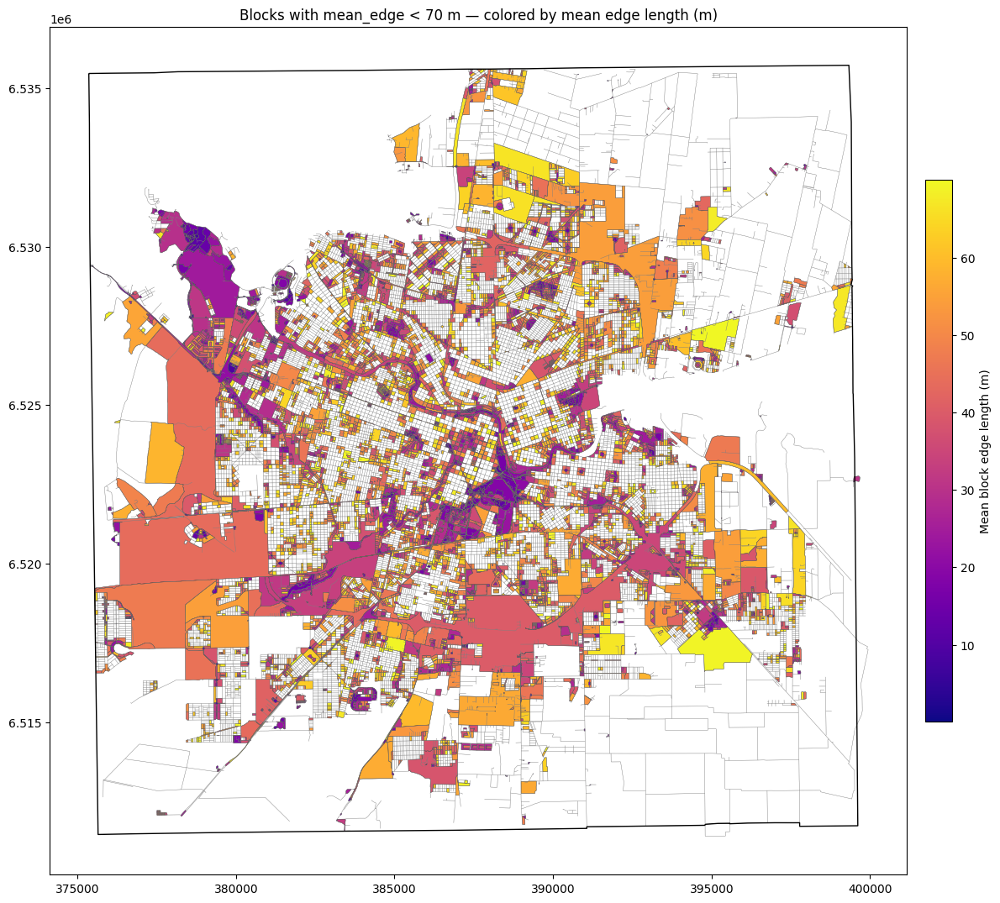

In [45]:
# choose upper bound on perimeter (keep blocks with perimeter < upper_bound)
upper_bound = 70  # meters (upper bound)
# can be perimeter or mean_edge, etc.
column = 'mean_edge'
blocks_filtered = blocks_gdf[blocks_gdf[column] < upper_bound].copy()

print(f"blocks total: {len(blocks_gdf)}; kept ({column} < {upper_bound} m): {len(blocks_filtered)}")
if len(blocks_filtered):
    print(f"{column} range in kept blocks: {blocks_filtered[column].min():.1f} – {blocks_filtered[column].max():.1f} m")
    print(blocks_filtered[[column, 'perimeter']].describe(percentiles=[0.25, 0.5, 0.75]))
else:
    print("No blocks kept with that threshold.")

blocks_filtered = blocks_filtered.dropna(subset=[column])

fig, ax = plt.subplots(figsize=(12, 12))
ax.xaxis.set_major_formatter(ScalarFormatter(useOffset=False, useLocale=False))
ax.yaxis.set_major_formatter(ScalarFormatter(useOffset=False, useLocale=False))

vmin = blocks_filtered[column].min()
vmax = blocks_filtered[column].max()
norm = Normalize(vmin=vmin, vmax=vmax)

blocks_filtered.plot(column=column, cmap='plasma', norm=norm, legend=False, ax=ax, edgecolor='k', linewidth=0.2)
edges_proj.plot(ax=ax, color='gray', linewidth=0.3, alpha=0.6)
gpd.GeoSeries([admin_proj]).boundary.plot(ax=ax, color='black', linewidth=1)

sm = ScalarMappable(cmap='plasma', norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax, fraction=0.03, pad=0.02)
cbar.set_label('Mean block edge length (m)')

ax.set_title(f"Blocks with {column} < {upper_bound} m — colored by mean edge length (m)")
plt.tight_layout()

out_png = os.path.join("images", f"blocks_{column}_lt_{upper_bound}m.png")
fig.savefig(out_png, dpi=300, bbox_inches='tight')
print(f"Saved plot to: {out_png}")

plt.draw()

edges_proj.crs: EPSG:32720

Largest blocks by perimeter:


,perimeter,area,mean_edge,centroid_within
1912,42077.469162,1.566704e+07,44.064283,True
2994,34839.685548,7.702603e+06,40.085490,True
2974,31061.422719,5.811948e+06,54.177619,True
0,16255.694548,1.597237e+06,34.880055,True
13890,14418.929562,7.705912e+06,89.945599,True
27,14053.838432,2.086779e+06,33.244846,True
13770,12132.006954,2.377361e+06,54.648680,True
13860,11712.004671,5.461839e+06,101.843519,True
17212,11421.612158,4.302423e+06,47.196744,True
13833,10720.775746,2.264735e+06,56.535657,True



Smallest blocks by perimeter:


,perimeter,area,mean_edge,centroid_within
19517,0.370383,0.005884,0.123461,True
17326,7.078148,1.437127,2.359383,True
809,7.366445,1.375811,2.455482,True
265,7.772410,3.771681,1.943102,True
723,8.039899,3.029724,2.679966,True
18025,8.282135,4.282597,1.380356,True
1722,8.430912,3.053209,2.810304,True
582,10.261300,6.495306,2.565325,True
671,10.962615,7.352594,2.740654,True
20696,11.413723,6.382510,2.853431,True



Summary stats:


,perimeter,area,mean_edge
count,20787.000000,2.078700e+04,20787.000000
mean,438.563228,1.912491e+04,62.164513
std,692.473214,1.788063e+05,36.675022
min,0.370383,5.883977e-03,0.123461
25%,277.930238,3.217441e+03,33.841272
50%,384.663117,7.888411e+03,60.859163
75%,469.939166,1.161822e+04,87.202162
max,42077.469162,1.566704e+07,897.339030



Filtered blocks (perimeter < 600 m and centroid within city): 18968
Saved plot to: images/blocks_perimeter_perimeter_lt_600m_centroid_within.png


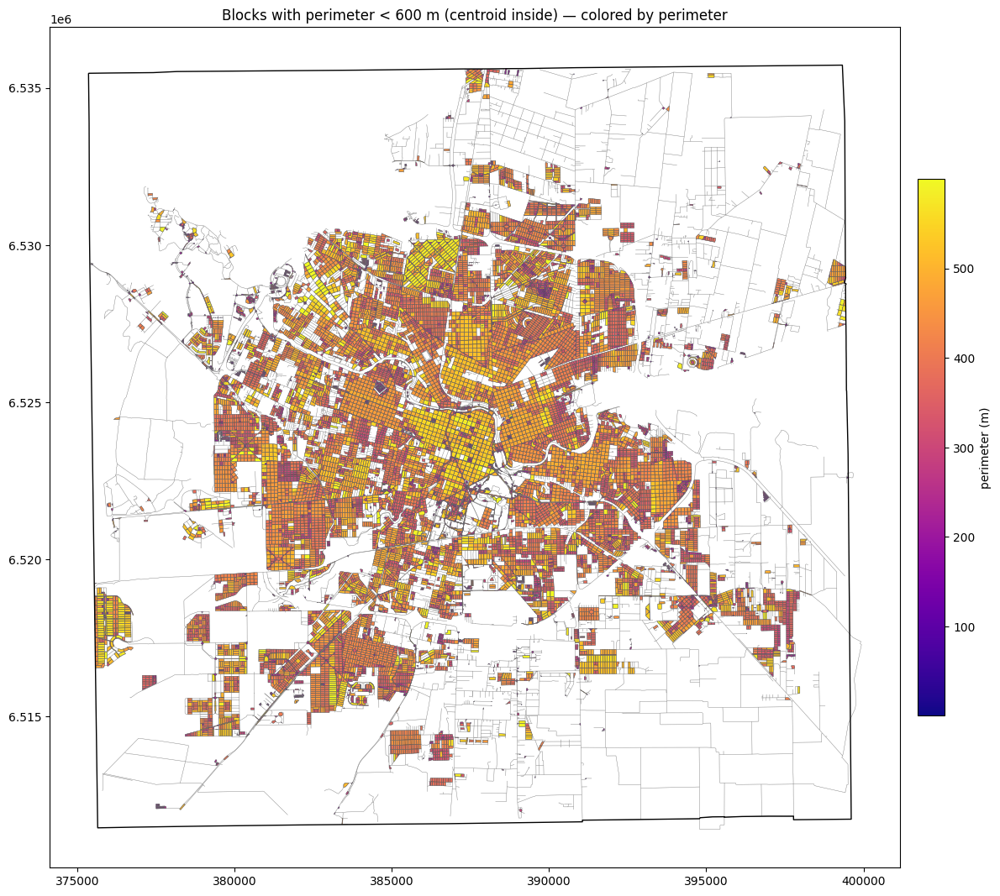

In [48]:
# ...existing code...
# Diagnostic + correct filtering and plotting (use perimeter and centroid test)

# 1) quick checks
print("edges_proj.crs:", edges_proj.crs)
blocks_gdf['area'] = blocks_gdf.geometry.area
blocks_gdf['centroid'] = blocks_gdf.geometry.centroid
blocks_gdf['centroid_within'] = blocks_gdf['centroid'].apply(lambda p: p.within(admin_proj))

# show largest / smallest by perimeter and mean_edge
print("\nLargest blocks by perimeter:")
display(blocks_gdf[['perimeter','area','mean_edge','centroid_within']].sort_values('perimeter', ascending=False).head(10))

print("\nSmallest blocks by perimeter:")
display(blocks_gdf[['perimeter','area','mean_edge','centroid_within']].sort_values('perimeter', ascending=True).head(10))

# show distribution summary
print("\nSummary stats:")
display(blocks_gdf[['perimeter','area','mean_edge']].describe())

# 2) filtering: use perimeter (meters) and require centroid inside admin polygon
upper_bound = 600  # meters (example)
filtered = blocks_gdf[(blocks_gdf['perimeter'] < upper_bound) & (blocks_gdf['centroid_within'])].copy()
print(f"\nFiltered blocks (perimeter < {upper_bound} m and centroid within city): {len(filtered)}")

# 3) plot filtered result colored by chosen column (mean_edge or perimeter)
column = 'perimeter'  # or 'perimeter'
filtered = filtered.dropna(subset=[column])

fig, ax = plt.subplots(figsize=(12,12))
ax.xaxis.set_major_formatter(ScalarFormatter(useOffset=False, useLocale=False))
ax.yaxis.set_major_formatter(ScalarFormatter(useOffset=False, useLocale=False))

vmin = filtered[column].min()
vmax = filtered[column].max()
norm = Normalize(vmin=vmin, vmax=vmax)

filtered.plot(column=column, cmap='plasma', norm=norm, legend=False, ax=ax, edgecolor='k', linewidth=0.2)
# show only edges inside bbox for speed/clarity
minx, miny, maxx, maxy = filtered.total_bounds
try:
    edges_sub = edges_proj.cx[minx:maxx, miny:maxy]
except Exception:
    bbox = box(minx, miny, maxx, maxy)
    edges_sub = edges_proj[edges_proj.intersects(bbox)]
edges_sub.plot(ax=ax, color='gray', linewidth=0.3, alpha=0.6)

gpd.GeoSeries([admin_proj]).boundary.plot(ax=ax, color='black', linewidth=1)

sm = ScalarMappable(cmap='plasma', norm=norm)
sm.set_array([])
cbar = fig.colorbar(sm, ax=ax, fraction=0.03, pad=0.02)
cbar.set_label(f'{column} (m)')

ax.set_title(f'Blocks with perimeter < {upper_bound} m (centroid inside) — colored by {column}')
plt.tight_layout()

# 4) save
out_png = os.path.join("images", f"blocks_{column}_perimeter_lt_{upper_bound}m_centroid_within.png")
fig.savefig(out_png, dpi=300, bbox_inches='tight')
print(f"Saved plot to: {out_png}")

plt.show()


### Extra
Veamos cómo se ve esto con un poco de zoom...

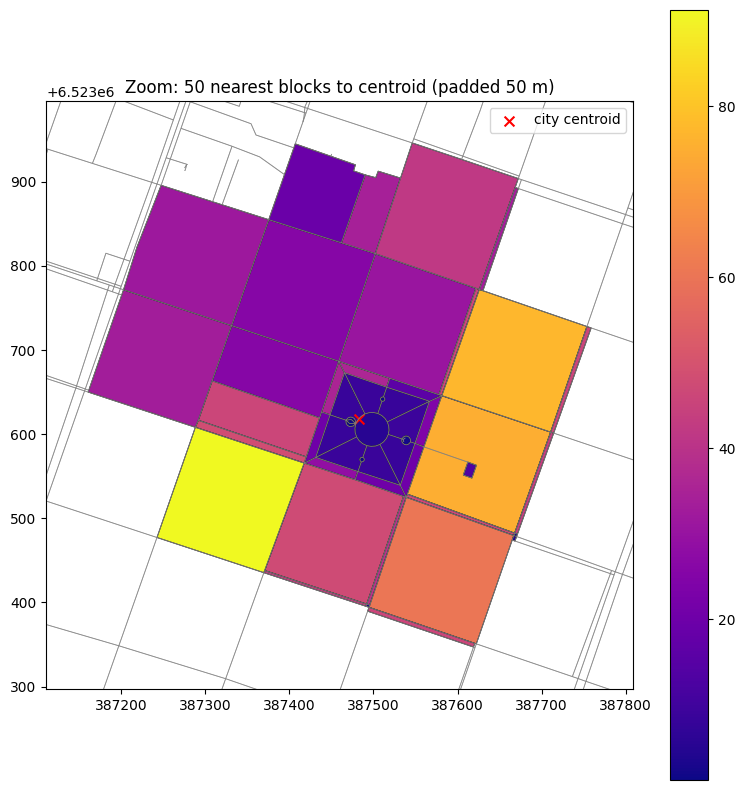

In [36]:
# Zoom to ~5x5 blocks near city centroid: select 25 nearest blocks by centroid distance and plot

# number of blocks to show (5x5 ~ 25)
n_blocks = 50
pad = 50  # meters padding around extent

# ensure admin_proj (city polygon in projected CRS) exists
centroid_pt = admin_proj.centroid

# compute block centroids and distance to city centroid
block_centroids = blocks_gdf.geometry.centroid
distances = block_centroids.distance(centroid_pt)

# pick n nearest blocks
nearest_idx = distances.nsmallest(n_blocks).index
nearest_blocks = blocks_gdf.loc[nearest_idx].copy()

# compute extent and pad
minx, miny, maxx, maxy = nearest_blocks.total_bounds
minx, miny, maxx, maxy = (minx - pad, miny - pad, maxx + pad, maxy + pad)

# subset edges for plotting (optional, speeds up drawing)
try:
    edges_sub = edges_proj.cx[minx:maxx, miny:maxy]
except Exception:
    # fallback: spatial filter
    bbox = box(minx, miny, maxx, maxy)
    edges_sub = edges_proj[edges_proj.intersects(bbox)]

# plot focused area
fig, ax = plt.subplots(figsize=(8, 8))
nearest_blocks.plot(column='mean_edge', cmap='plasma', legend=True, ax=ax, edgecolor='k', linewidth=0.6)
edges_sub.plot(ax=ax, color='gray', linewidth=0.6, alpha=0.7)
gpd.GeoSeries([centroid_pt]).plot(ax=ax, color='red', marker='x', markersize=50, label='city centroid')

ax.set_xlim(minx, maxx)
ax.set_ylim(miny, maxy)
ax.set_title(f"Zoom: {n_blocks} nearest blocks to centroid (padded {pad} m)")
ax.legend()
plt.tight_layout()
plt.draw()

In [37]:
out_png = os.path.join("images", f"blocks_perimeter_gt_{upper_bound}m.png")
fig.savefig(out_png, dpi=300, bbox_inches='tight')
print(f"Saved plot to: {out_png}")

Saved plot to: images/blocks_perimeter_gt_1000m.png
